In [86]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import probplot,boxcox
from sklearn.preprocessing import LabelEncoder,StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split,StratifiedKFold,GridSearchCV
from sklearn.utils import resample
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
import joblib
import warnings
warnings.filterwarnings('ignore')

In [2]:
pd.set_option('display.max_columns',None)
df=pd.read_csv('hr_attrition.csv')
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,2,Married,5130,24907,1,Y,No,23,4,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,4,Male,92,2,1,Laboratory Technician,3,Single,2090,2396,6,Y,Yes,15,3,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,4,Female,56,3,1,Research Scientist,3,Married,2909,23159,1,Y,Yes,11,3,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,1,Male,40,3,1,Laboratory Technician,2,Married,3468,16632,9,Y,No,12,3,4,80,1,6,3,3,2,2,2,2


## EDA

In [3]:
df.shape

(1470, 35)

- data has 1470 observations and 35 features

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

- only int and object type data is present, no float type data is there

In [5]:
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

- no null values are present in our data set

In [6]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,2.728571,6502.931293,14313.103401,2.693197,15.209524,3.153741,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,1.102846,4707.956783,7117.786044,2.498009,3.659938,0.360824,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,1.000000,1009.000000,2094.000000,0.000000,11.000000,3.000000,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,2.000000,2911.000000,8047.000000,1.000000,12.000000,3.000000,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,3.000000,4919.000000,14235.500000,2.000000,14.000000,3.000000,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,4.000000,8379.000000,20461.500000,4.000000,18.000000,3.000000,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,4.000000,19999.000000,26999.000000,9.000000,25.000000,4.000000,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


- age is normally distributed(mean~median), and is free from outliers
- DailyRate is also normally distributed. it is also seems free from outliers(verify it later)
- distance from home seems free from outliers, but data seems right Skewed
- education is a categorical data
- employee count is fixed, so we need to drop this column
- employee number is normally distributed, but need to check if it is just the id no. or not
- EnvironmentSatisfaction is an ordinal data
- hourlyrate is normally distributed and seems free from outliers
- JobInvolvement is an ordinal data
- JobLevel is an ordinal data
- JobSatisfaction is an ordinal data
- monthly income is right skewed and may possess outliers(need to verify it)
- monthly rate is a little skewed. need to check the amount of skewness
- NumCompaniesWorked is little right skewed
- PercentSalaryHike is also little right skewed
- PerformanceRating is an ordinal data
- RelationshipSatisfaction is an ordinal data
- StandardHours seems fixed so we may need to droop this column
- StockOptionLevel is an ordinal data
- TotalWorkingYears is a little right skewed
- TrainingTimesLastYear seems normally distributed
- WorkLifeBalance is an ordinal data
- YearsAtCompany is right skewed
- YearsInCurrentRole is right skewed
- YearsSinceLastPromotion is right skewed
- YearsWithCurrManager is also right skewed

### Dropping the unnecesary columns

In [7]:
df.drop(['EmployeeCount','StandardHours'],axis=1,inplace=True)

In [8]:
df.skew()

Age                         0.413286
DailyRate                  -0.003519
DistanceFromHome            0.958118
Education                  -0.289681
EmployeeNumber              0.016574
EnvironmentSatisfaction    -0.321654
HourlyRate                 -0.032311
JobInvolvement             -0.498419
JobLevel                    1.025401
JobSatisfaction            -0.329672
MonthlyIncome               1.369817
MonthlyRate                 0.018578
NumCompaniesWorked          1.026471
PercentSalaryHike           0.821128
PerformanceRating           1.921883
RelationshipSatisfaction   -0.302828
StockOptionLevel            0.968980
TotalWorkingYears           1.117172
TrainingTimesLastYear       0.553124
WorkLifeBalance            -0.552480
YearsAtCompany              1.764529
YearsInCurrentRole          0.917363
YearsSinceLastPromotion     1.984290
YearsWithCurrManager        0.833451
dtype: float64

- there is some skewness in several points which needs to be removed later
- but before lets check the q-q plot to check how much data is normally distributed

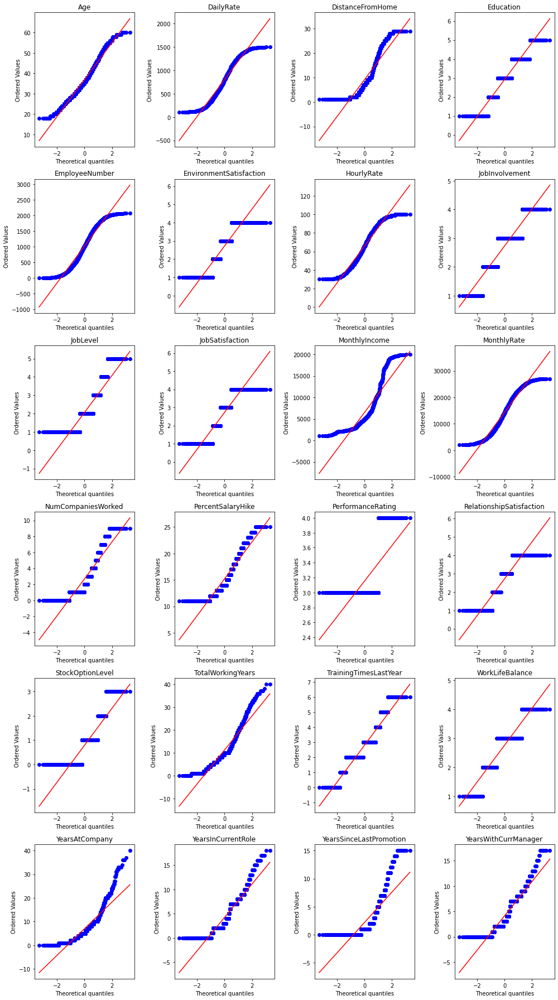

In [9]:
cl=df.describe().columns
plt.figure(figsize=(14,25))
for i in range(len(cl)):
    plt.subplot(6,4,i+1)
    probplot(df[cl[i]],plot=plt,dist='norm')
    plt.title(cl[i])
    plt.tight_layout()

Skewness is to be removed from the following features as the data is not that normally distributed:
- DistanceFromHome
- MonthlyIncome
- NumCompaniesWorked
- TotalWorkingYears
- YearsAtCompany
- YearsSinceLastPromotion
- YearsWithCurrManager

In [10]:
df.describe(include=['O'])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


- need to check if the data is cleaned or not. there may be chances of multiple names of same category
- over18 column has same value for all the observations, so we need to drop this column

In [11]:
df.drop('Over18',axis=1,inplace=True)

In [12]:
c=df.describe(include=['O']).columns
c

Index(['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender',
       'JobRole', 'MaritalStatus', 'OverTime'],
      dtype='object')

In [13]:
for i in c:
    print(df[i].value_counts())
    print('-------------')

No     1233
Yes     237
Name: Attrition, dtype: int64
-------------
Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: BusinessTravel, dtype: int64
-------------
Research & Development    961
Sales                     446
Human Resources            63
Name: Department, dtype: int64
-------------
Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: EducationField, dtype: int64
-------------
Male      882
Female    588
Name: Gender, dtype: int64
-------------
Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: JobRole, dtype: int64
-------------
Married     673
Single      470
Divorced    327
Name: MaritalStatus, 

- data is cleamed, no duplicacy found.
- lets check the count plot for more insights

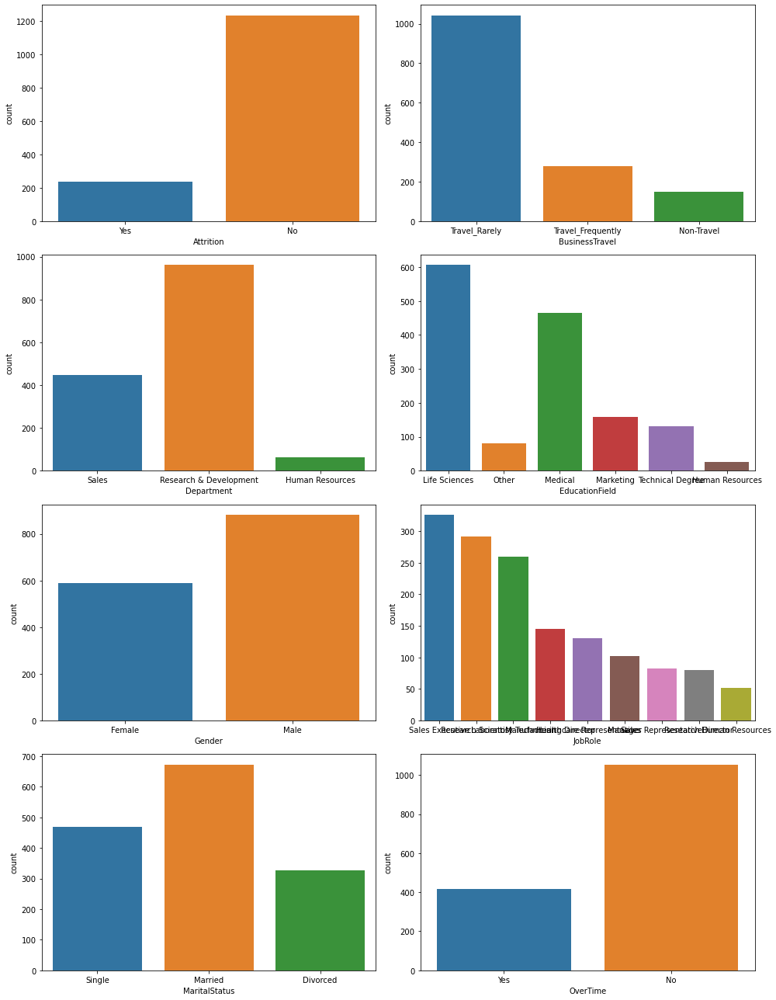

In [14]:
plt.figure(figsize=(14,18))
for i in range(len(c)):
    plt.subplot(4,2,i+1)
    sns.countplot(df[c[i]])
    plt.tight_layout()

- data set is imbalanced as attrition data shows huge difference
- most of the people travel rarely
- most of the people are in R&D department
- most of the people are from either life sciences or Medical science. very few from HR
- mostly working people are males
- mostly people are working as sales  executive, very few are in HR
- mostly people are married but there is a significant amount of divorced people there
- mostly people dont do overtime

<AxesSubplot:xlabel='JobRole', ylabel='count'>

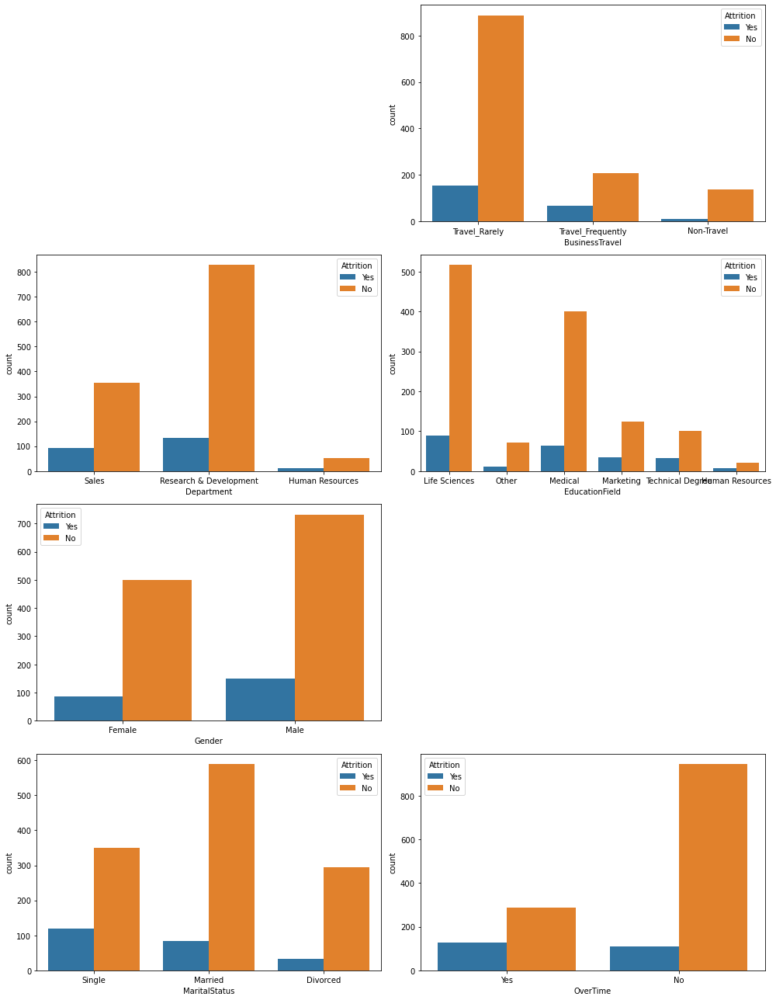

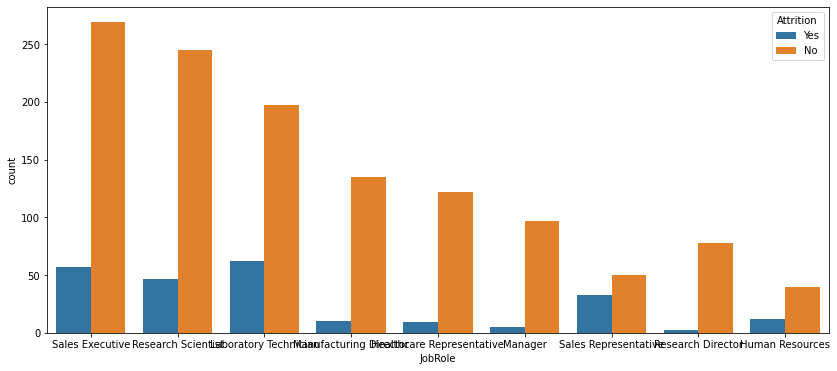

In [15]:
plt.figure(figsize=(14,18))
for i in range(len(c)):
    if c[i]!='JobRole' and c[i]!='Attrition':
        plt.subplot(4,2,i+1)
        sns.countplot(df[c[i]],hue=df['Attrition'])
        plt.tight_layout()
plt.figure(figsize=(14,6))
sns.countplot(df['JobRole'],hue=df['Attrition'])

- in each and every case, there is lower attrition
- people who travel frequently has higher attrition rate
- people from HR, technical degree and marketing degree have higher attrition rate as compared to other fields
- people who are single have higher attrition rate as compared to others
- people who work over time have higher attrition rate
- people whho are sales Representative have higher attrition rate

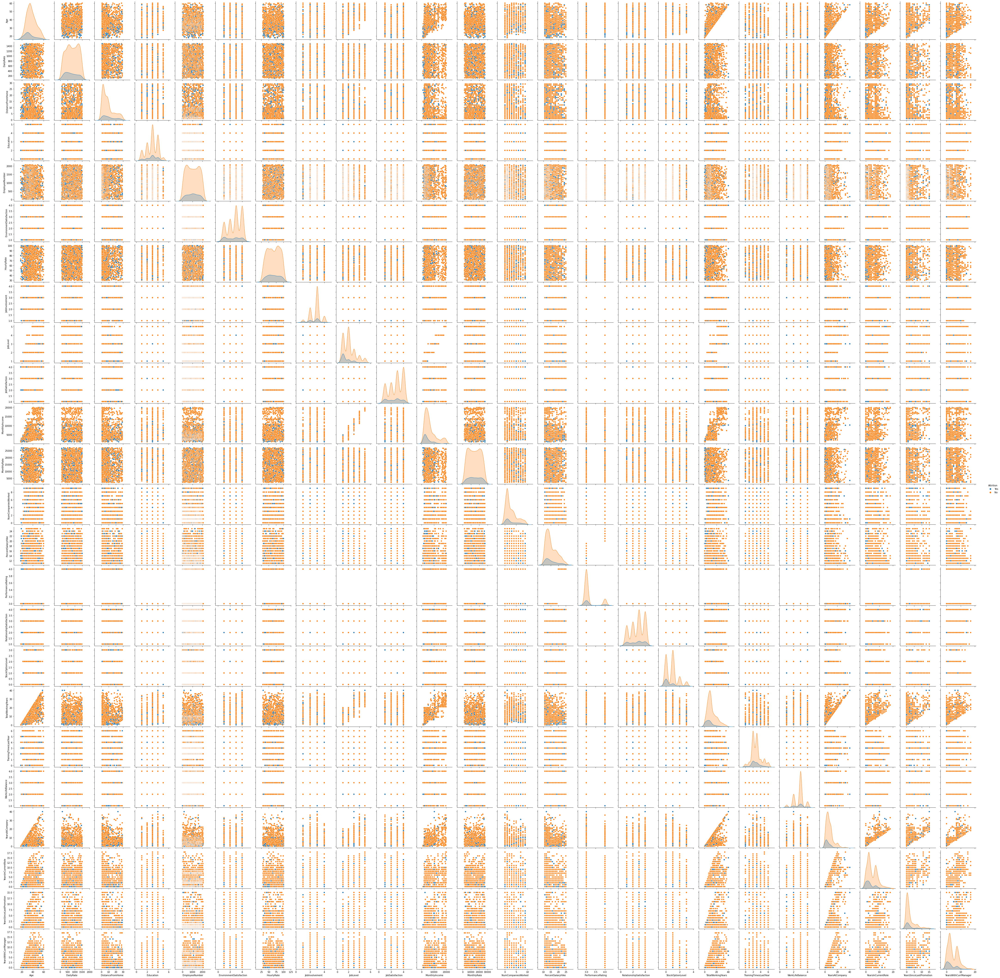

In [16]:
sns.pairplot(df,hue='Attrition')

- as it is difficult to read pairplot, lets use for loop to plot the data

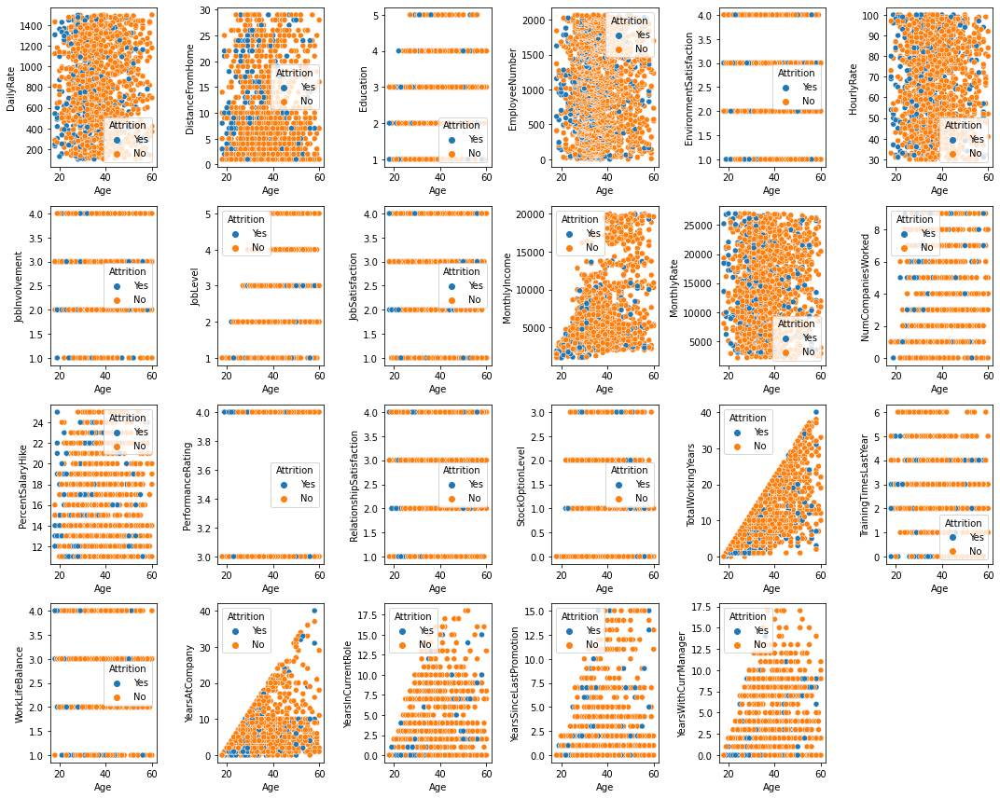

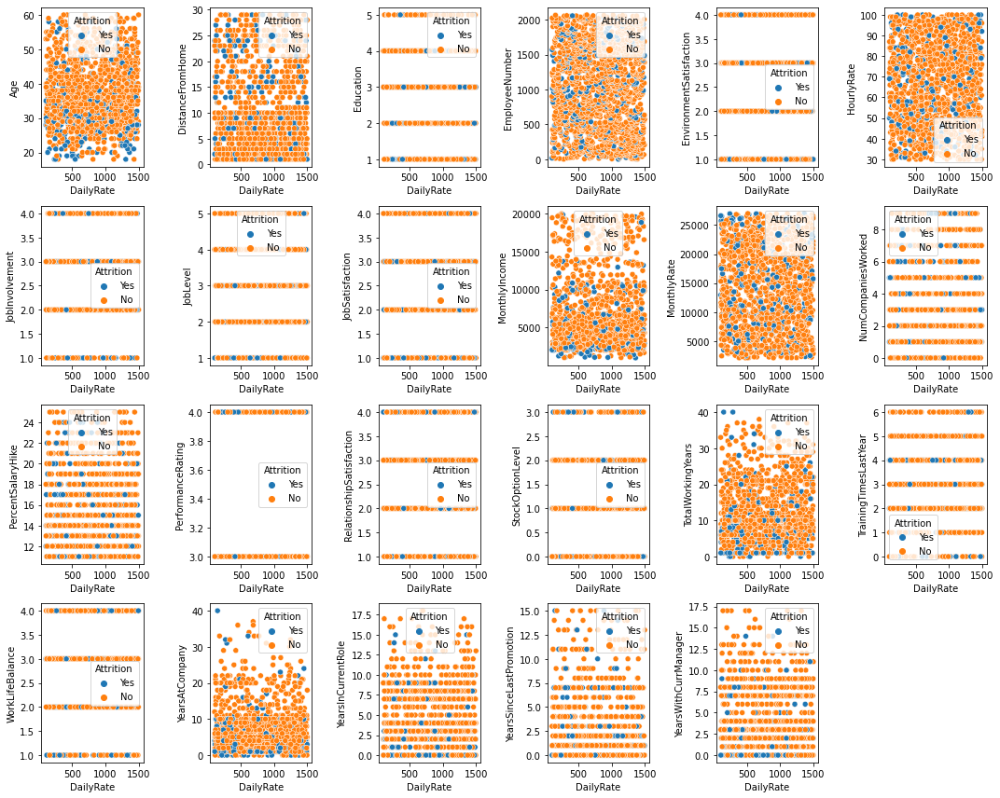

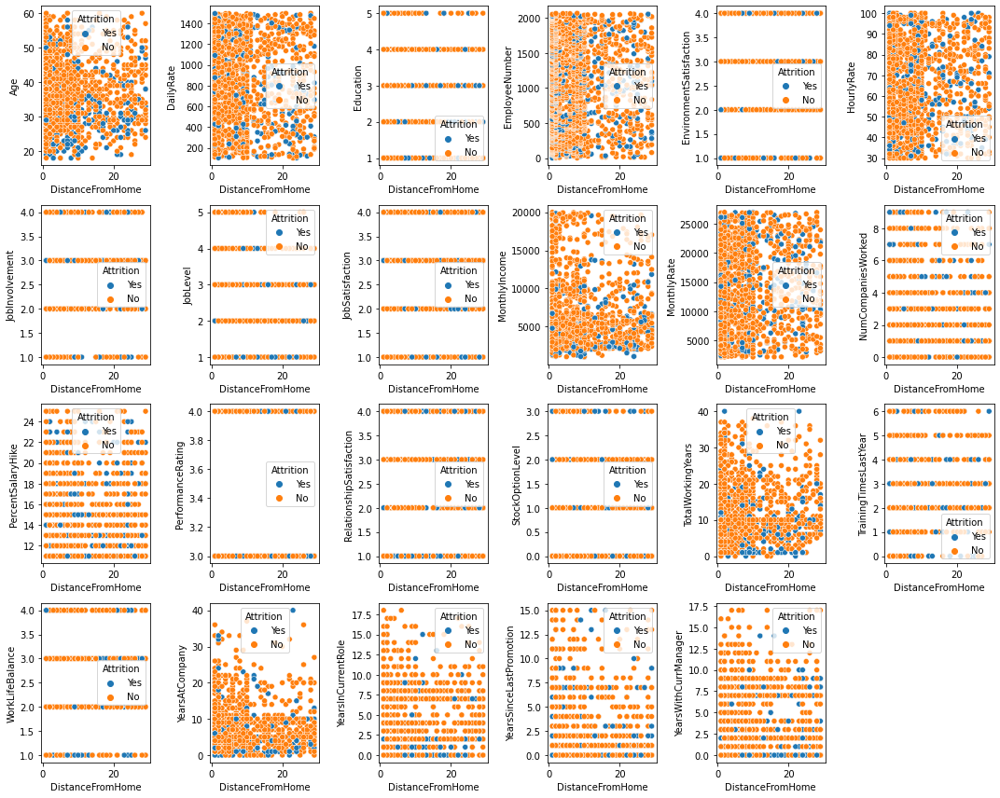

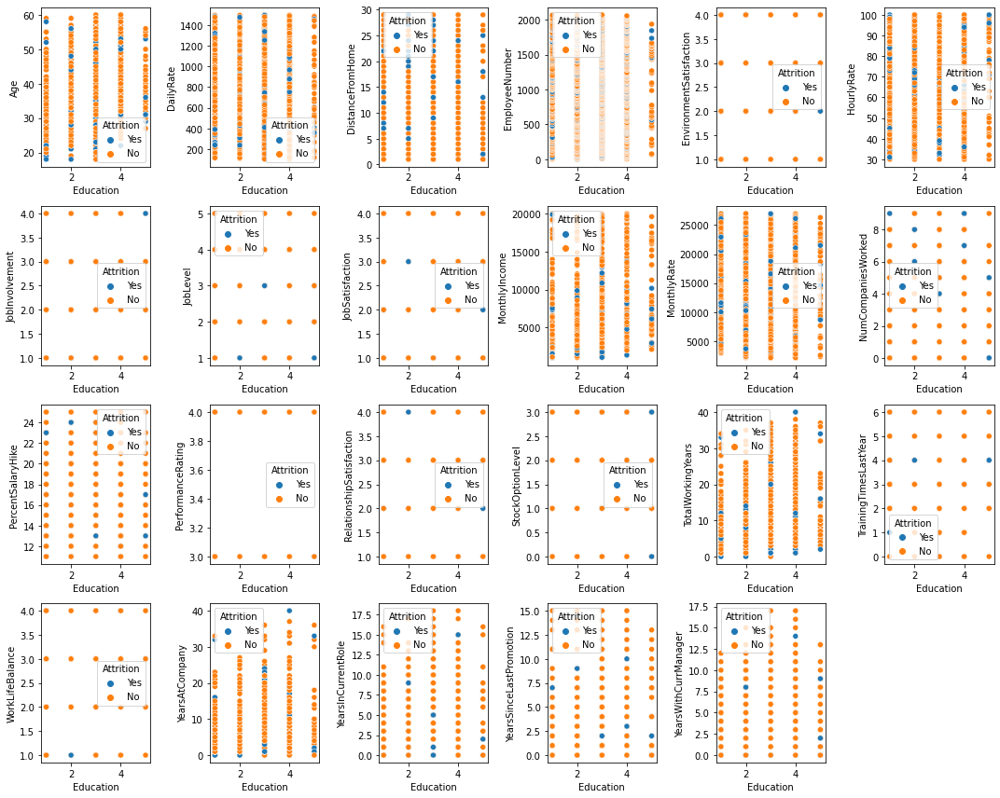

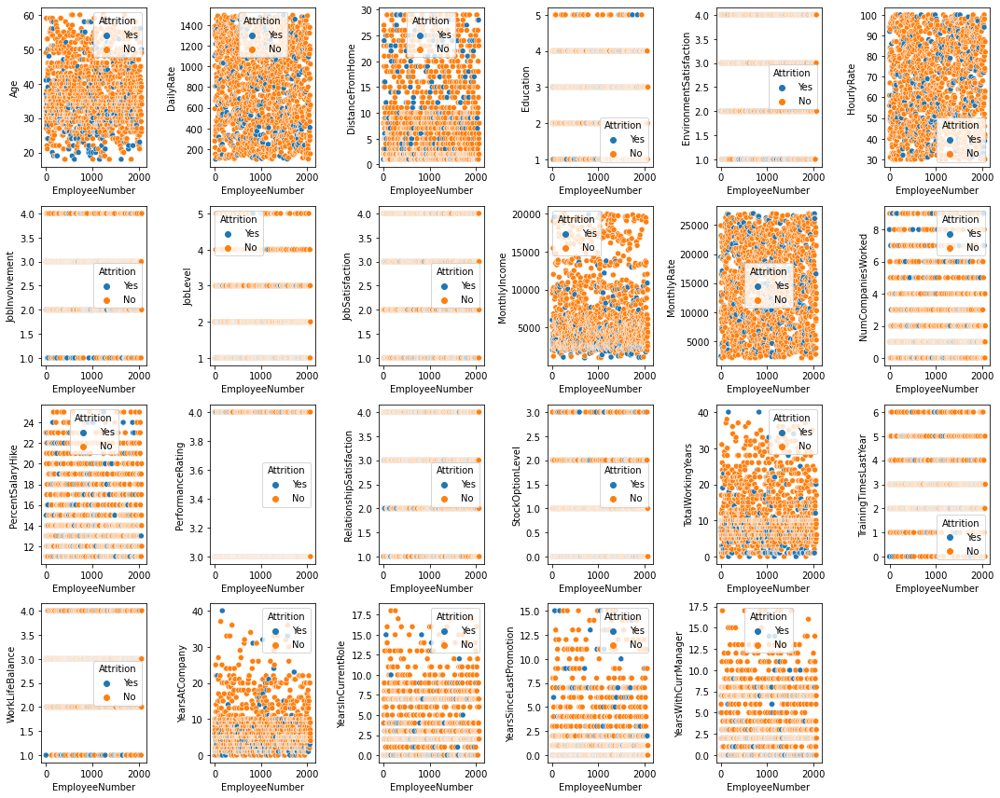

...

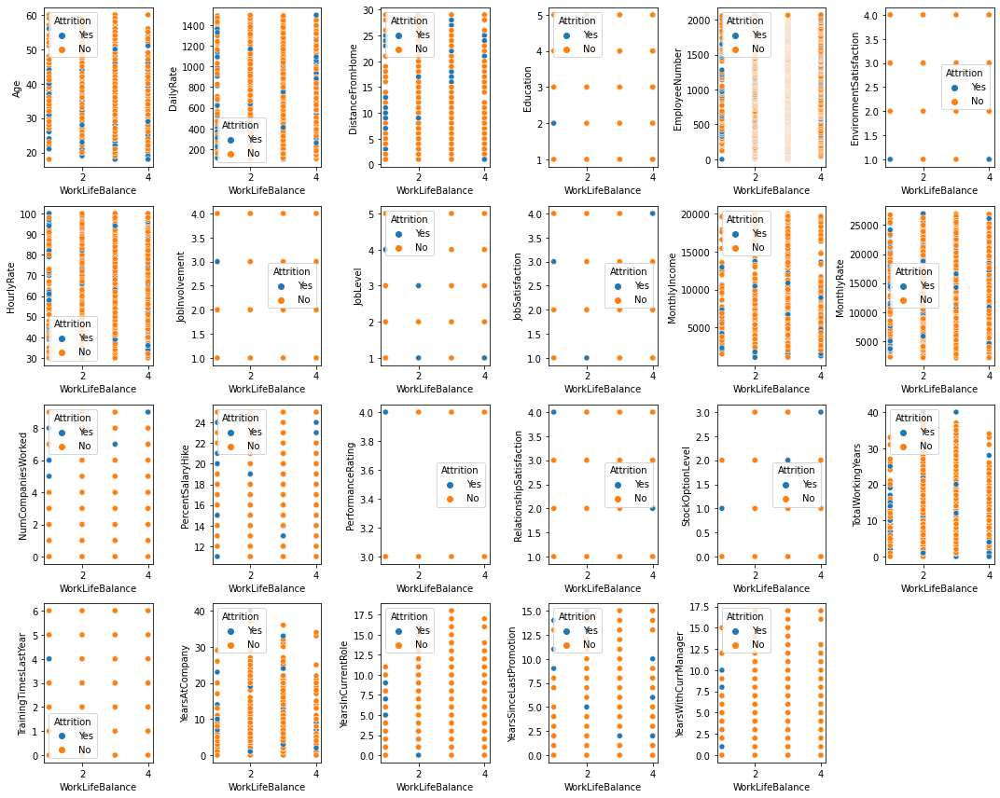

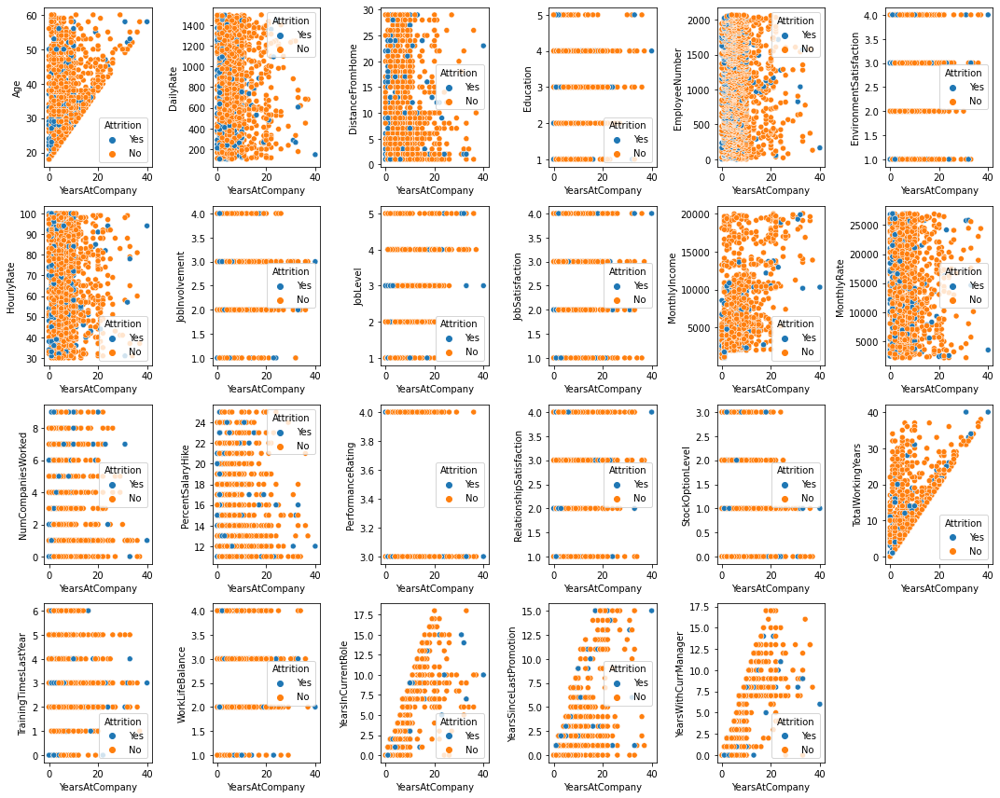

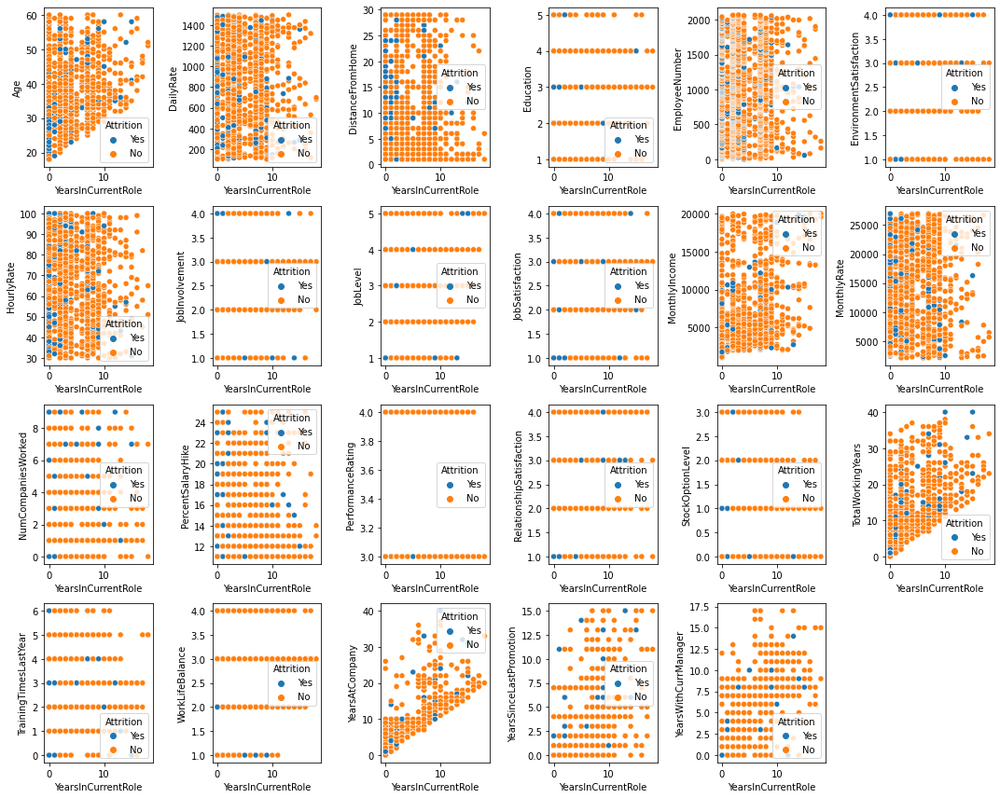

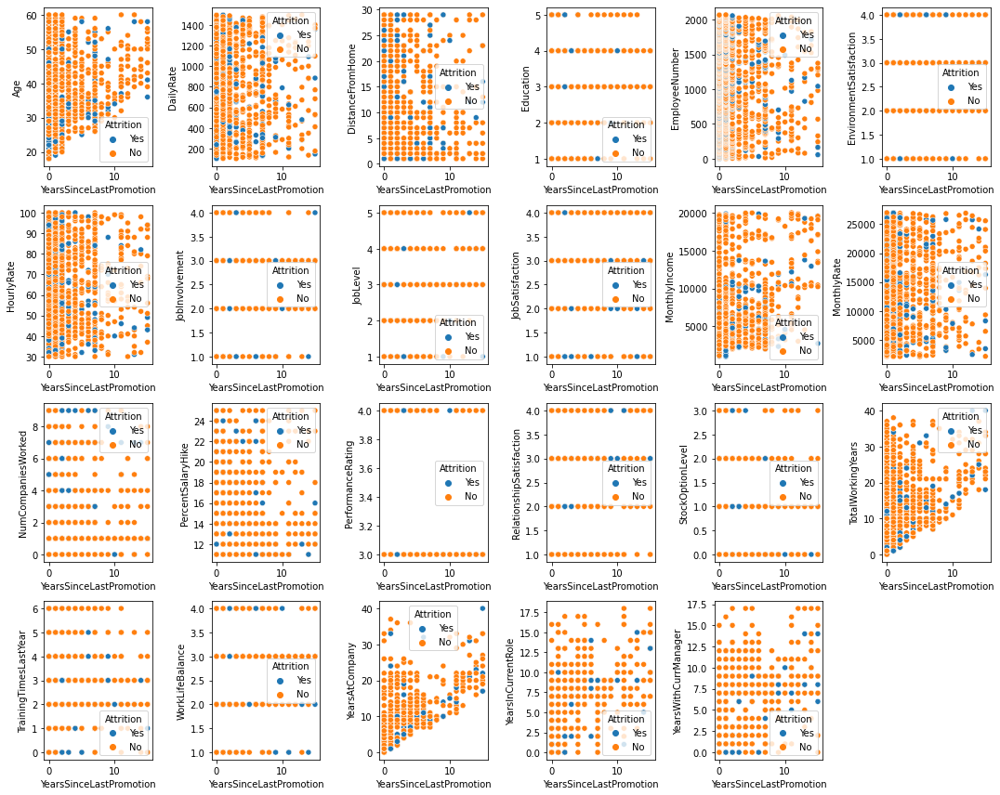

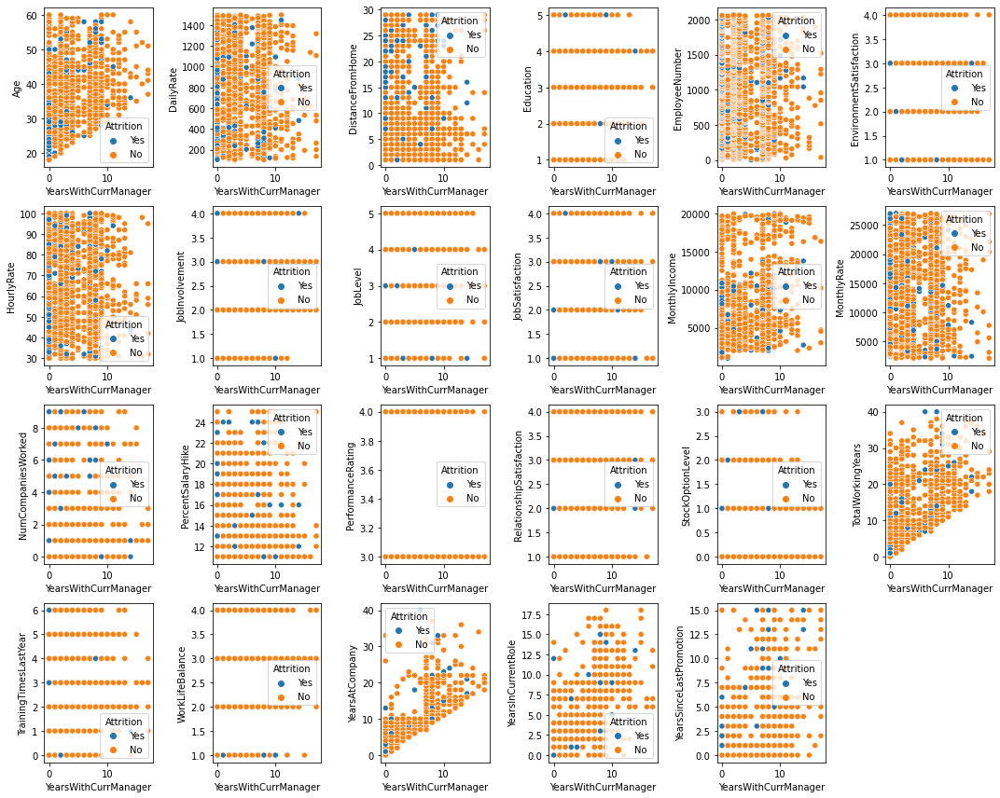

In [17]:
#for loop to scatterplot the data in reasonable size
for i in range(len(cl)):
    k=1
    plt.figure(figsize=(15,12))
    for j in range(len(cl)):
        if cl[i]!=cl[j]:
            plt.subplot(4,6,k)
            sns.scatterplot(x=cl[i],y=cl[j],data=df,hue='Attrition')
            plt.tight_layout()
            k+=1
    plt.show()

- as monthly income and age increases, attrition rate decreases
- monthly income increases with increase in job level, also attrition rate decreases
- as total working years increases, monthly income also increases()some level of colinearity)
- people with higher performance rating has higher salary hike(also need to replace these values with 0 and 1)
- people with less working years has high attrition rate
- data is not linearlly separable, some points are randomly distributed some are making clusters(can try SVC,KNN)

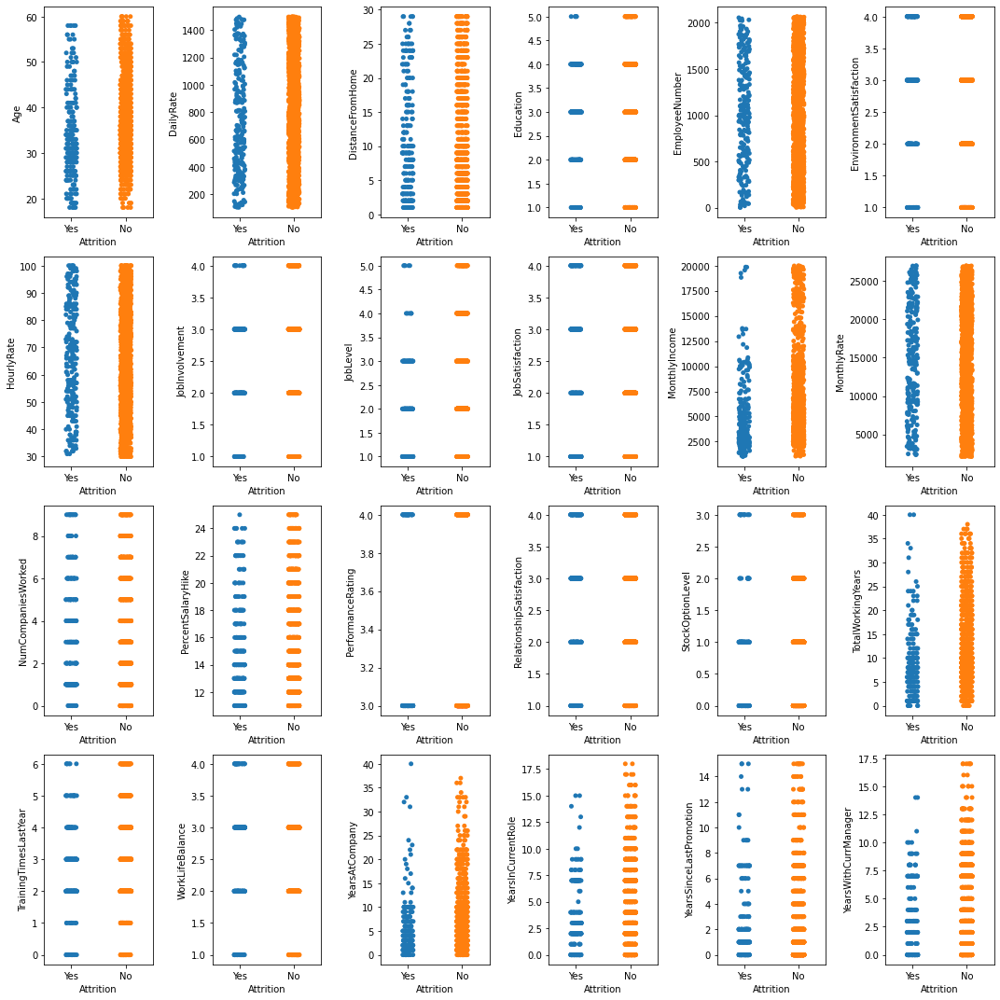

In [18]:
plt.figure(figsize=(15,15))
for i in range(len(cl)):
    plt.subplot(4,6,i+1)
    sns.stripplot(x='Attrition',y=cl[i],data=df)
    plt.tight_layout()

- attrition rate is lower with higher monthly income as inferred before
- as total working years increases, attrition rate decreases
- if years at company is higher, then attrition rate is lower

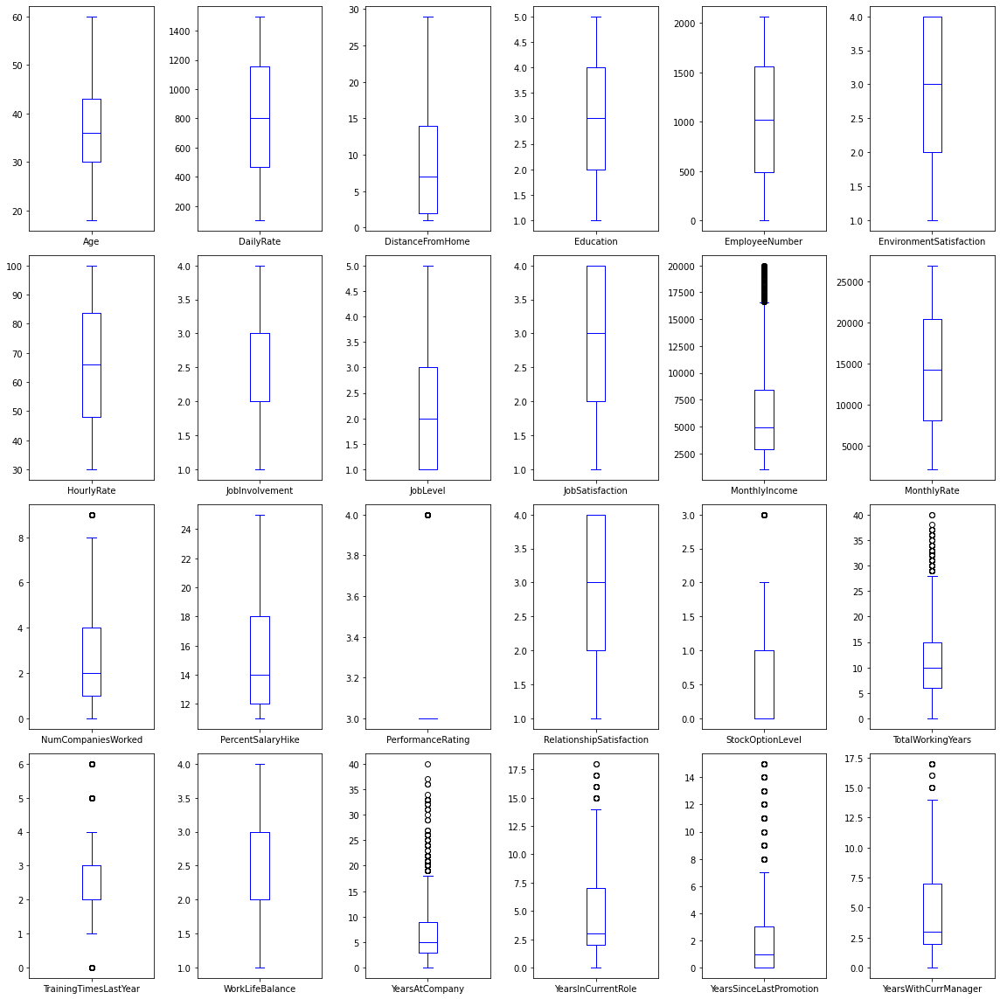

In [19]:
#checking for outliers
df.plot(kind='box',color='b',subplots=True,layout=(4,6),figsize=(16,16))
plt.tight_layout()

- as per the plots their are outliers, but these points are reasonably valid as per the data(can be checked through describe() method)

In [22]:
df['EmployeeNumber'].nunique()

1470

<AxesSubplot:xlabel='EmployeeNumber', ylabel='Count'>

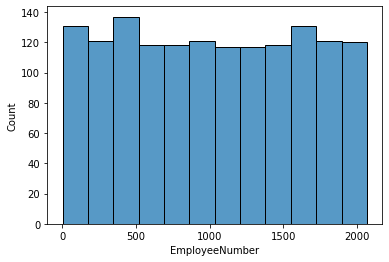

In [13]:
sns.histplot(df['EmployeeNumber'])

- EmployeeNumber has 1470 unique values which is equal to the total number of observations
- histogram of EmployeeNumber is uniformly distributed 

-- these two points infer that this feature is just the number id of employee, so we can drop this feature

In [14]:
df.drop('EmployeeNumber',axis=1,inplace=True)

### Normalizing Data

In [15]:
# making a function to check different methods of normalizing data
def norm(feature):
    plt.figure(figsize=(10,20))
    plt.subplot(6,2,1)
    sns.histplot(df[feature])
    plt.subplot(6,2,2)
    probplot(df[feature],plot=plt,dist='norm')
    plt.title(feature)
    # method-1 log transformation
    a=np.log(df[feature]+1)
    plt.subplot(6,2,3)
    sns.histplot(a)
    plt.subplot(6,2,4)
    probplot(a,plot=plt,dist='norm')
    plt.title('log transformation')
    #method-2 boxcox
    # 0 -> for log transformation
    # 0.5-> for square root trasnform
    a=boxcox(df[feature]+1,0)
    plt.subplot(6,2,5)
    sns.histplot(a)
    plt.subplot(6,2,6)
    probplot(a,plot=plt,dist='norm')
    plt.title('boxcox transformation')
    #method-3 reciprocal
    a=1/(df[feature]+1)
    plt.subplot(6,2,7)
    sns.histplot(a)
    plt.subplot(6,2,8)
    probplot(a,plot=plt,dist='norm')
    plt.title('reciprocal transformation')
    #method-4 squareroot 
    a=df[feature]**0.5
    plt.subplot(6,2,9)
    sns.histplot(a)
    plt.subplot(6,2,10)
    probplot(a,plot=plt,dist='norm')
    plt.title('sqrrt transformation')
    #method-5 exponential
    a=df[feature]**(1/5)  #approximation of exponential
    plt.subplot(6,2,11)
    sns.histplot(a)
    plt.subplot(6,2,12)
    probplot(a,plot=plt,dist='norm')
    plt.title('exponential transformation')
    plt.tight_layout()

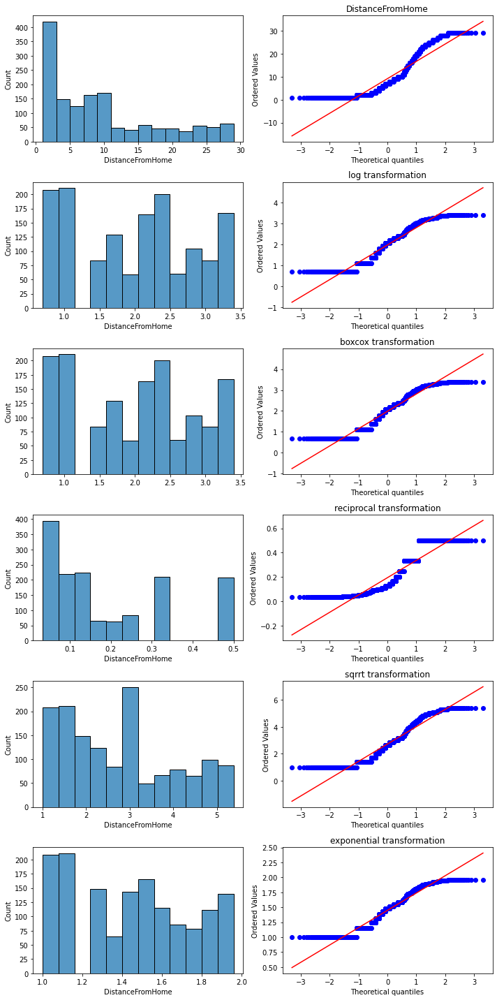

In [16]:
norm('DistanceFromHome')

- log transformation serves the purpose

In [17]:
print('skewness before ',df['DistanceFromHome'].skew())
df['DistanceFromHome']=np.log(df['DistanceFromHome']+1)
print('skewness after ',df['DistanceFromHome'].skew())

skewness before  0.9581179956568269
skewness after  -0.029120785364396513


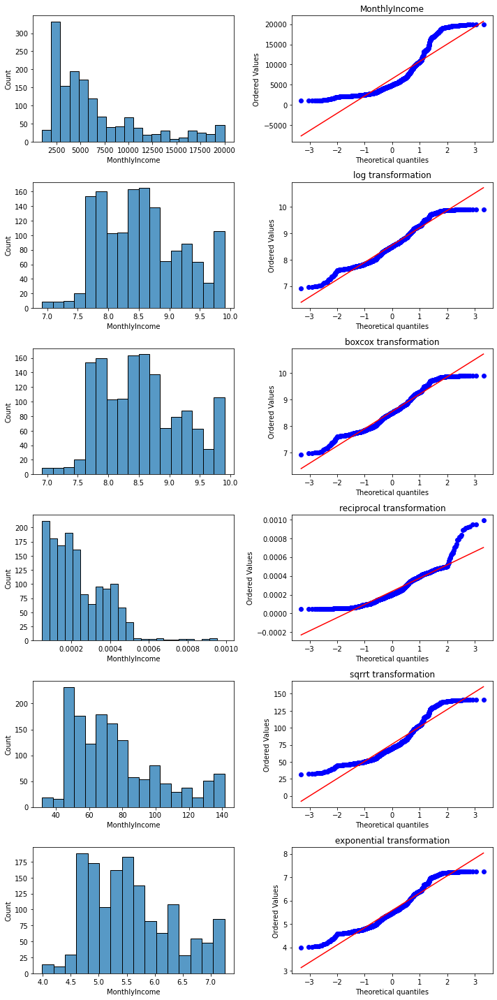

In [18]:
norm('MonthlyIncome')

- log transformation serves the purpose

In [19]:
print('skewness before ',df['MonthlyIncome'].skew())
df['MonthlyIncome']=np.log(df['MonthlyIncome']+1)
print('skewness after ',df['MonthlyIncome'].skew())

skewness before  1.3698166808390662
skewness after  0.2864483763069351


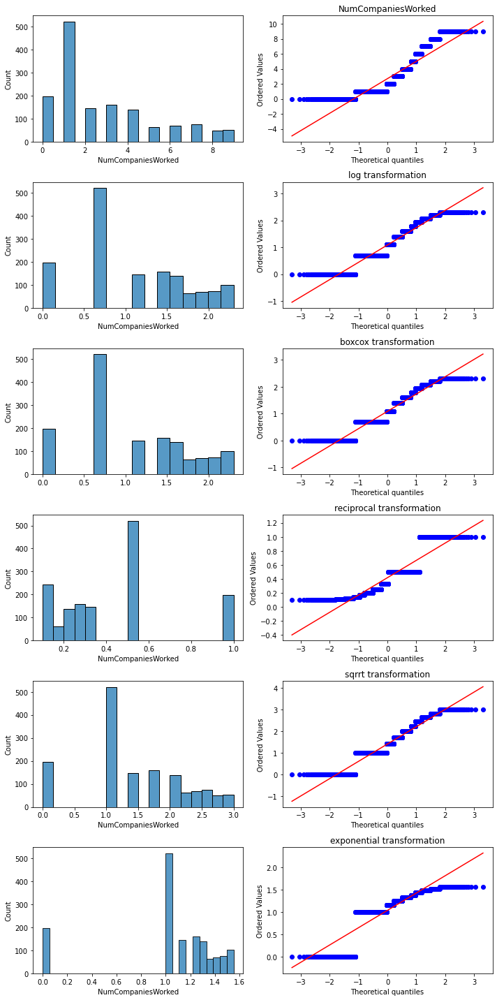

In [20]:
norm('NumCompaniesWorked')

- log transformation serves the purpose

In [21]:
print('skewness before ',df['NumCompaniesWorked'].skew())
df['NumCompaniesWorked']=np.log(df['NumCompaniesWorked']+1)
print('skewness after ',df['NumCompaniesWorked'].skew())

skewness before  1.026471111968205
skewness after  0.09289622460196824


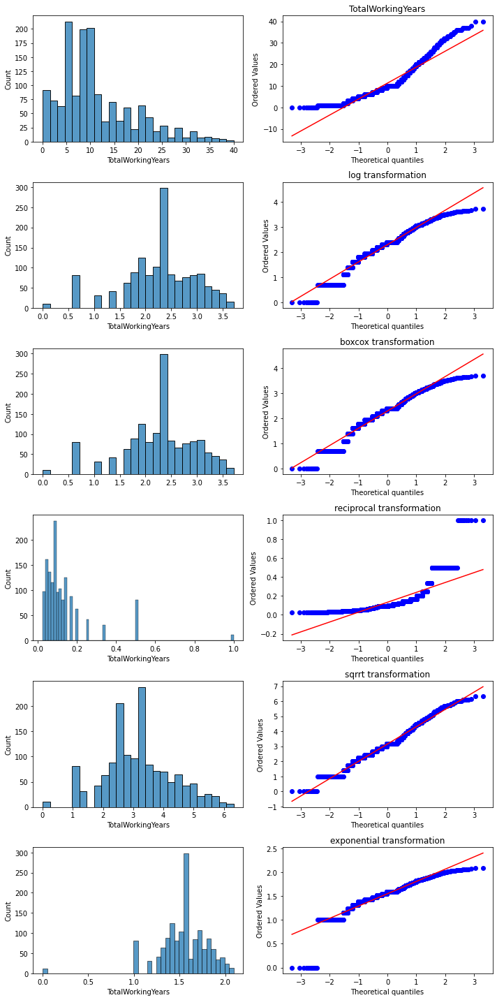

In [22]:
norm('TotalWorkingYears')

- sqrrt transformation serves the purpose

In [23]:
print('skewness before ',df['TotalWorkingYears'].skew())
df['TotalWorkingYears']=df['TotalWorkingYears']**0.5
print('skewness after ',df['TotalWorkingYears'].skew())

skewness before  1.1171718528128527
skewness after  0.17635832785911423


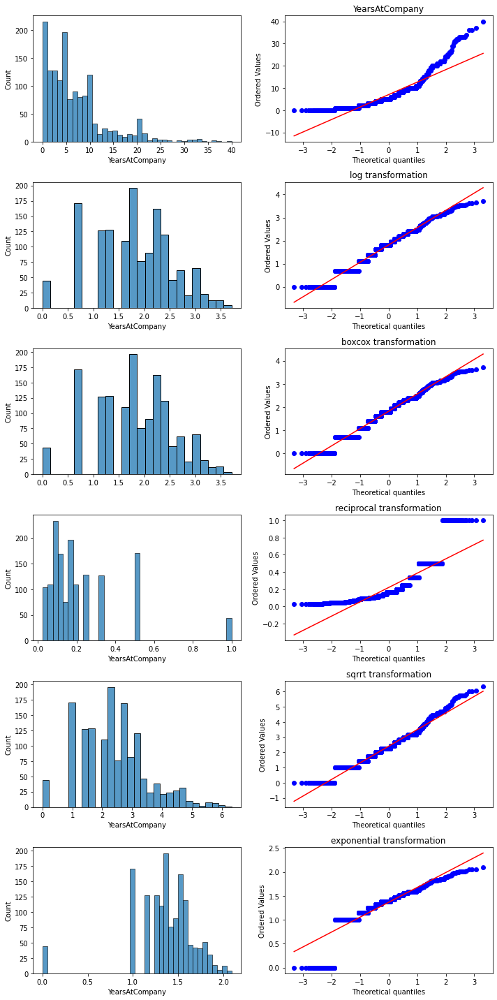

In [24]:
norm('YearsAtCompany')

- log transformation serves the purpose

In [25]:
print('skewness before ',df['YearsAtCompany'].skew())
df['YearsAtCompany']=np.log(df['YearsAtCompany']+1)
print('skewness after ',df['YearsAtCompany'].skew())

skewness before  1.7645294543422085
skewness after  -0.20770795300104433


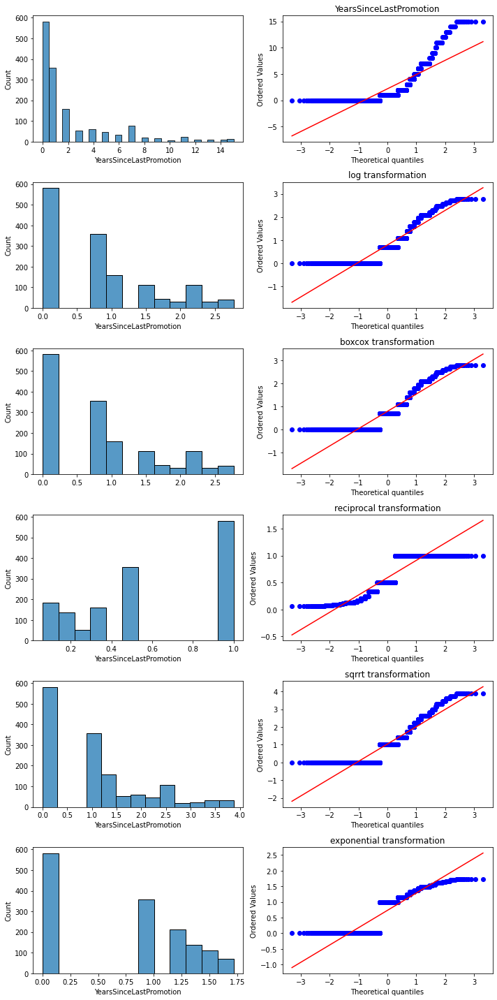

In [26]:
norm('YearsSinceLastPromotion')

- log transformation serves the purpose

In [27]:
print('skewness before ',df['YearsSinceLastPromotion'].skew())
df['YearsSinceLastPromotion']=np.log(df['YearsSinceLastPromotion']+1)
print('skewness after ',df['YearsSinceLastPromotion'].skew())

skewness before  1.9842899833524859
skewness after  0.7188045525459852


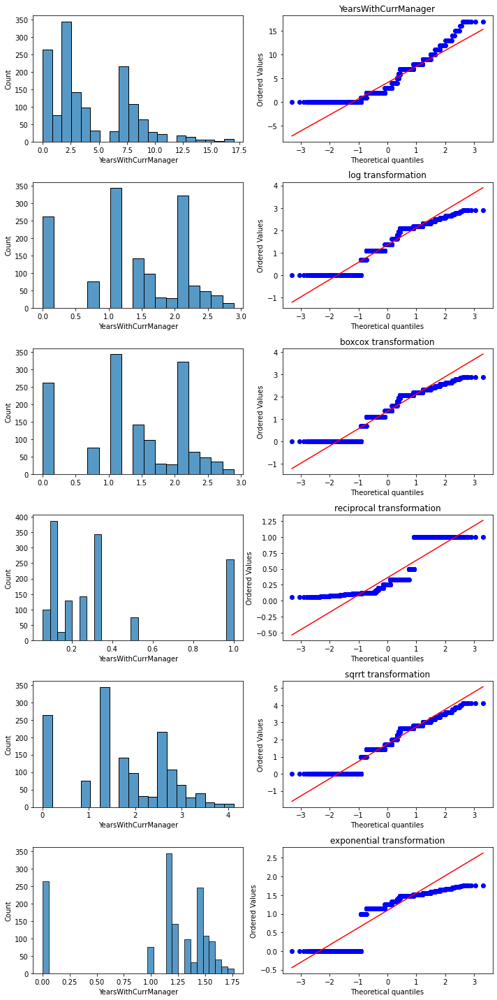

In [28]:
norm('YearsWithCurrManager')

- sqrrt transformation serves the purpose

In [29]:
print('skewness before ',df['YearsWithCurrManager'].skew())
df['YearsWithCurrManager']=df['YearsWithCurrManager']**0.5
print('skewness after ',df['YearsWithCurrManager'].skew())

skewness before  0.8334509919918475
skewness after  -0.2546108293708109


In [30]:
# replacing values of PerformanceRating with 0 and 1 to reduce noise
# repplacing 3 ---> 0
# replacing 4 ----> 1
df['PerformanceRating'].replace(3,0,inplace=True)
df['PerformanceRating'].replace(4,1,inplace=True)
df['PerformanceRating'].unique()

array([0, 1], dtype=int64)

In [31]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,0.693147,2,Life Sciences,2,Female,94,3,2,Sales Executive,4,Single,8.698514,19479,2.197225,Yes,11,0,1,0,2.828427,0,1,1.945910,4,0.000000,2.236068
1,49,No,Travel_Frequently,279,Research & Development,2.197225,1,Life Sciences,3,Male,61,2,2,Research Scientist,2,Married,8.543056,24907,0.693147,No,23,1,4,1,3.162278,3,3,2.397895,7,0.693147,2.645751
2,37,Yes,Travel_Rarely,1373,Research & Development,1.098612,2,Other,4,Male,92,2,1,Laboratory Technician,3,Single,7.645398,2396,1.945910,Yes,15,0,2,0,2.645751,3,3,0.000000,0,0.000000,0.000000
3,33,No,Travel_Frequently,1392,Research & Development,1.386294,4,Life Sciences,4,Female,56,3,1,Research Scientist,3,Married,7.975908,23159,0.693147,Yes,11,0,3,0,2.828427,3,3,2.197225,7,1.386294,0.000000
4,27,No,Travel_Rarely,591,Research & Development,1.098612,1,Medical,1,Male,40,3,1,Laboratory Technician,2,Married,8.151622,16632,2.302585,No,12,0,4,1,2.449490,3,3,1.098612,2,1.098612,1.414214


In [32]:
# encoding categorical data into numerical data
le=LabelEncoder()
for i in c:
    df[i]=le.fit_transform(df[i])

### Splitting data

In [33]:
x=df.drop('Attrition',axis=1)
y=df['Attrition']

## Scaling Data

In [34]:
sc=StandardScaler()
x=sc.fit_transform(x)
x=pd.DataFrame(x)
x.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
0,0.446350,0.590048,0.742527,1.401512,-1.505350,-0.891688,-0.937414,-0.660531,-1.224745,1.383138,0.379672,-0.057788,1.032716,1.153254,1.236820,0.219493,0.726020,1.660254,1.591746,-1.150554,-0.426230,-1.584178,-0.932014,-0.278944,-2.171982,-2.493820,0.177344,-0.063296,-0.973342,0.474052
1,1.322365,-0.913194,-1.297775,-0.493817,0.252002,-1.868426,-0.937414,0.254625,0.816497,-0.240677,-1.026167,-0.057788,0.626374,-0.660853,-0.133282,-0.014600,1.488876,-0.586417,-0.628241,2.129306,2.346151,1.191438,0.241988,0.008926,0.155707,0.338096,0.774724,0.764998,-0.117271,0.865142
2,0.008343,0.590048,1.414363,-0.493817,-1.031607,-0.891688,1.316673,1.169781,0.816497,1.284725,-1.026167,-0.961486,-0.998992,0.246200,1.236820,-1.366318,-1.674841,1.284860,1.591746,-0.057267,-0.426230,-0.658973,-0.932014,-0.436461,0.155707,0.338096,-2.394527,-1.167687,-0.973342,-1.660530
3,-0.429664,-0.913194,1.461466,-0.493817,-0.695482,1.061787,-0.937414,1.169781,-1.224745,-0.486709,0.379672,-0.961486,0.626374,0.246200,-0.133282,-0.868626,1.243211,-0.586417,1.591746,-1.150554,-0.426230,0.266233,-0.932014,-0.278944,0.155707,0.338096,0.509502,0.764998,0.738799,-1.660530
4,-1.086676,0.590048,-0.524295,-0.493817,-1.031607,-1.868426,0.565311,-1.575686,0.816497,-1.274014,0.379672,-0.961486,-0.998992,-0.660853,-0.133282,-0.604032,0.325900,1.817633,-0.628241,-0.877232,-0.426230,1.191438,0.241988,-0.605693,0.155707,0.338096,-0.942513,-0.615492,0.383498,-0.310501


## PCA for feature selection

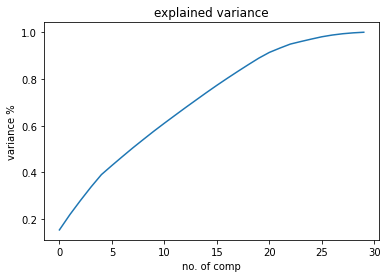

In [35]:
# with the help of scree plot
pca=PCA()
principlecomponents=pca.fit_transform(x)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('no. of comp')
plt.ylabel('variance %')
plt.title('explained variance')
plt.show()

- we can see around 25 components give 95% explained variance

In [36]:
np.cumsum(pca.explained_variance_ratio_)

array([0.15363407, 0.21933108, 0.27941643, 0.33687379, 0.39038109,
       0.42946547, 0.46759898, 0.50508788, 0.54100605, 0.57648063,
       0.61055058, 0.64381303, 0.67689596, 0.70920398, 0.74138252,
       0.7727183 , 0.80297708, 0.83244763, 0.86122536, 0.88918572,
       0.91359817, 0.93205072, 0.94928558, 0.96022874, 0.97067387,
       0.98056749, 0.9880438 , 0.99361155, 0.99745884, 1.        ])

In [37]:
comp=np.cumsum(pca.explained_variance_ratio_)
print('no. of comp ','explained variance')
for  i,j in enumerate(comp):
    print('     ',i+1,'     ',j)

no. of comp  explained variance
      1       0.15363406884496572
      2       0.2193310803010037
      3       0.2794164294566235
      4       0.33687379332569645
      5       0.39038109490584055
      6       0.4294654710153147
      7       0.46759898006079825
      8       0.5050878768686383
      9       0.5410060463991155
      10       0.5764806301296612
      11       0.610550584800578
      12       0.6438130289255704
      13       0.676895964534411
      14       0.7092039799755422
      15       0.7413825213697195
      16       0.7727183014492365
      17       0.8029770752891334
      18       0.8324476297568552
      19       0.861225364067658
      20       0.8891857220376819
      21       0.913598172236528
      22       0.9320507157798267
      23       0.9492855836710856
      24       0.9602287440246648
      25       0.9706738671019631
      26       0.9805674881235388
      27       0.9880437964236621
      28       0.993611549248361
      29       0.997458844

- so 24 components are giving >95% variance

In [38]:
pca=PCA(n_components=24)
newdata=pca.fit_transform(x)
X=pd.DataFrame(newdata)
X.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
0,-0.090078,0.499200,-1.844848,-1.673463,0.388194,0.310187,-2.396804,-0.619493,-0.341673,3.542865,-0.664243,1.644185,-0.124180,0.409810,1.444256,0.003612,-0.542659,1.433244,-0.227699,0.685923,1.337035,0.972063,-0.588679,0.257643
1,0.908878,-1.055509,2.934431,-1.070359,0.033482,1.171745,0.673457,-0.522019,-1.336828,-1.730917,0.911286,0.887558,-1.028687,-0.449545,0.200682,1.365608,0.118872,-0.222604,-0.435841,0.335885,0.426432,1.208853,1.391652,0.125595
2,-3.344842,1.810595,-0.319362,-0.377828,-1.407288,0.367521,0.269538,1.611882,2.065476,0.814585,-1.242275,0.974787,-0.996648,1.089898,0.142523,-1.214182,1.464696,0.131736,0.372928,-0.160490,1.359186,-0.203576,0.052372,0.307795
3,-0.731692,-0.596306,-1.171043,0.268555,-0.363677,1.557583,-0.875174,0.582954,-0.019387,0.124306,0.245764,0.535136,2.474920,-0.533359,1.362343,-0.415167,0.393683,-0.070342,0.117383,-1.445399,0.115062,-0.788777,0.357662,-1.104344
4,-1.661357,0.612617,-0.454135,1.148665,-0.933886,-0.270498,1.114284,0.024794,0.489593,-0.776219,0.447508,0.620759,-0.910728,-0.712105,-0.779262,1.282624,-2.277153,0.286103,-0.777099,0.044421,1.858641,-0.469742,-0.995373,0.250848


### Train test split

In [39]:
x_train,x_test,y_train,y_test=train_test_split(X,y,test_size=.2,random_state=42,stratify=y)

### Balancing the dataset

### Upsampling

In [40]:
x1=pd.concat([x_train,y_train],axis=1)

In [41]:
yes=x1[x1.Attrition==1]
no=x1[x1.Attrition==0]

In [42]:
yes_up=resample(yes,
               replace=True,
               n_samples=len(no),
               random_state=26)

#### combining the data

In [43]:
upsamples=pd.concat([yes_up,no])
upsamples.Attrition.value_counts()

1    986
0    986
Name: Attrition, dtype: int64

In [44]:
x_train=upsamples.drop('Attrition',axis=1)
y_train=upsamples['Attrition']

## Modeling

In [57]:
# deefining a model
def model_test(model):
    ml=model()
    ml.fit(x_train,y_train)
    y_pred=ml.predict(x_test)
    print('accuracy score ',accuracy_score(y_test,y_pred))
    y_predd=ml.predict(x_train)
    print('training accuracy ',accuracy_score(y_train,y_predd))
    print('confusion matrix \n',confusion_matrix(y_test,y_pred))
    print('classification report \n',classification_report(y_test,y_pred))
    #cross validation
    kfold=StratifiedKFold(n_splits=10)
    accuracy=[]
    for train_index,test_index in kfold.split(x_train,y_train):
        xtrain,xtest=x_train.iloc[train_index],x_train.iloc[test_index]
        ytrain,ytest=y_train.iloc[train_index],y_train.iloc[test_index]
        ml.fit(xtrain,ytrain)
        ypred=ml.predict(xtest)
        accuracy.append(accuracy_score(ytest,ypred))
    print('cross validation accuracy \n',accuracy)
    print('mean accuracy score ',sum(accuracy)/len(accuracy))

In [58]:
model_test(LogisticRegression)

accuracy score  0.7551020408163265
training accuracy  0.7733265720081136
confusion matrix 
 [[184  63]
 [  9  38]]
classification report 
               precision    recall  f1-score   support

           0       0.95      0.74      0.84       247
           1       0.38      0.81      0.51        47

    accuracy                           0.76       294
   macro avg       0.66      0.78      0.67       294
weighted avg       0.86      0.76      0.78       294

cross validation accuracy 
 [0.6767676767676768, 0.7727272727272727, 0.7715736040609137, 0.751269035532995, 0.751269035532995, 0.8020304568527918, 0.8274111675126904, 0.7817258883248731, 0.7918781725888325, 0.7969543147208121]
mean accuracy score  0.7723606624621854


- accuracy is 75.5%
- there is very low bias in our model
- precision of 0 is 95% but of 1 is 38% which is not good
- recall of 0 is 74% and of 1 is 81%
- cross validation also giving same value of accuracy

In [59]:
model_test(SVC)

accuracy score  0.8401360544217688
training accuracy  0.9568965517241379
confusion matrix 
 [[221  26]
 [ 21  26]]
classification report 
               precision    recall  f1-score   support

           0       0.91      0.89      0.90       247
           1       0.50      0.55      0.53        47

    accuracy                           0.84       294
   macro avg       0.71      0.72      0.71       294
weighted avg       0.85      0.84      0.84       294

cross validation accuracy 
 [0.8838383838383839, 0.9090909090909091, 0.9137055837563451, 0.9035532994923858, 0.9289340101522843, 0.934010152284264, 0.9543147208121827, 0.8934010152284264, 0.9187817258883249, 0.8984771573604061]
mean accuracy score  0.9138106957903911


- testing accuracy is 84% but training accuracy is high that means the model is giving some biaseness
- again recall and precision are very low for 1(yes attrition)
- but cross validation is giving very ggod accuracy(91%)

In [60]:
model_test(KNeighborsClassifier)

accuracy score  0.6904761904761905
training accuracy  0.9163286004056795
confusion matrix 
 [[186  61]
 [ 30  17]]
classification report 
               precision    recall  f1-score   support

           0       0.86      0.75      0.80       247
           1       0.22      0.36      0.27        47

    accuracy                           0.69       294
   macro avg       0.54      0.56      0.54       294
weighted avg       0.76      0.69      0.72       294

cross validation accuracy 
 [0.8585858585858586, 0.8787878787878788, 0.8730964467005076, 0.8324873096446701, 0.868020304568528, 0.8578680203045685, 0.8375634517766497, 0.8477157360406091, 0.8426395939086294, 0.8121827411167513]
mean accuracy score  0.8508947341434652


- KNN is giving poor results
- precision and recall are also poor for 1
- but cross validation is giving moderate results

In [61]:
model_test(DecisionTreeClassifier)

accuracy score  0.7891156462585034
training accuracy  1.0
confusion matrix 
 [[220  27]
 [ 35  12]]
classification report 
               precision    recall  f1-score   support

           0       0.86      0.89      0.88       247
           1       0.31      0.26      0.28        47

    accuracy                           0.79       294
   macro avg       0.59      0.57      0.58       294
weighted avg       0.77      0.79      0.78       294

cross validation accuracy 
 [0.9090909090909091, 0.9343434343434344, 0.949238578680203, 0.9289340101522843, 0.9441624365482234, 0.9035532994923858, 0.9390862944162437, 0.9137055837563451, 0.9086294416243654, 0.934010152284264]
mean accuracy score  0.9264754140388659


- accuracy is 78% but the algorithm is very bias
- precision and recall of 1 is again very low(lowest amongst all)
- but cross validation is again good(92%)

In [62]:
model_test(RandomForestClassifier)

accuracy score  0.8469387755102041
training accuracy  1.0
confusion matrix 
 [[243   4]
 [ 41   6]]
classification report 
               precision    recall  f1-score   support

           0       0.86      0.98      0.92       247
           1       0.60      0.13      0.21        47

    accuracy                           0.85       294
   macro avg       0.73      0.56      0.56       294
weighted avg       0.81      0.85      0.80       294

cross validation accuracy 
 [1.0, 0.9747474747474747, 0.9949238578680203, 0.9847715736040609, 0.9898477157360406, 0.9898477157360406, 0.9949238578680203, 0.9847715736040609, 0.9593908629441624, 0.9847715736040609]
mean accuracy score  0.9857996205711942


- accuracy is 86%
- but model is bias
- precision is good for both the classifications but recall is very poor for 1
- cross validation is giving exceptionally good results

### best models:
- SVC
- Random forest
- decision tree

## Hyperparameter tuning

In [71]:
# tuning for SVC
params={'C':[1,10,20],
        'gamma':['scale','auto'],
        'kernel':['linear', 'poly', 'rbf', 'sigmoid'],
       'random_state':[42,]}

svc_grid=GridSearchCV(estimator=SVC(),
                     param_grid=params,
                     scoring='accuracy',
                     cv=10,
                     n_jobs=-1)

svc_grid.fit(x_train,y_train)
print('best score ',svc_grid.best_score_)
print('best parameters ',svc_grid.best_params_)

best score  0.9695867302466287
best parameters  {'C': 10, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42}


In [66]:
# creating function to test model
def model_test1(ml):
    ml.fit(x_train,y_train)
    y_pred=ml.predict(x_test)
    print('accuracy score ',accuracy_score(y_test,y_pred))
    y_predd=ml.predict(x_train)
    print('training accuracy ',accuracy_score(y_train,y_predd))
    print('confusion matrix \n',confusion_matrix(y_test,y_pred))
    print('classification report \n',classification_report(y_test,y_pred))
    #cross validation
    kfold=StratifiedKFold(n_splits=10)
    accuracy=[]
    for train_index,test_index in kfold.split(x_train,y_train):
        xtrain,xtest=x_train.iloc[train_index],x_train.iloc[test_index]
        ytrain,ytest=y_train.iloc[train_index],y_train.iloc[test_index]
        ml.fit(xtrain,ytrain)
        ypred=ml.predict(xtest)
        accuracy.append(accuracy_score(ytest,ypred))
    print('cross validation accuracy \n',accuracy)
    print('mean accuracy score ',sum(accuracy)/len(accuracy))

In [74]:
svc=SVC(C=10,gamma='auto',random_state=42)
model_test1(svc)

accuracy score  0.8469387755102041
training accuracy  1.0
confusion matrix 
 [[234  13]
 [ 32  15]]
classification report 
               precision    recall  f1-score   support

           0       0.88      0.95      0.91       247
           1       0.54      0.32      0.40        47

    accuracy                           0.85       294
   macro avg       0.71      0.63      0.66       294
weighted avg       0.82      0.85      0.83       294

cross validation accuracy 
 [0.9494949494949495, 0.9646464646464646, 0.9847715736040609, 0.9543147208121827, 0.9695431472081218, 0.9847715736040609, 0.9847715736040609, 0.9593908629441624, 0.9695431472081218, 0.9746192893401016]
mean accuracy score  0.9695867302466284


- model is overfitting the data
- still bad precision and recall

In [77]:
# tuning for decision tree
params={'criterion':['gini', 'entropy'],
        'max_depth':[14,16,18,20,22,24],
        'splitter':['best','random'],
        'min_samples_split':[2,4,6,10,12],
        'min_samples_leaf':[1,2,3,4],
        'max_features':['sqrt','log2',None],
        'random_state':[42,]}

dt_grid=GridSearchCV(estimator=DecisionTreeClassifier(),
                     param_grid=params,
                     scoring='accuracy',
                     cv=10,
                     n_jobs=-1)

dt_grid.fit(x_train,y_train)
print('best score ',dt_grid.best_score_)
print('best parameters ',dt_grid.best_params_)

best score  0.9320437881351588
best parameters  {'criterion': 'entropy', 'max_depth': 22, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'random_state': 42, 'splitter': 'best'}


In [78]:
dt=DecisionTreeClassifier(criterion='entropy',
                         max_depth=22,
                         max_features='sqrt',
                         splitter='best',
                         random_state=42)
model_test1(dt)

accuracy score  0.7891156462585034
training accuracy  1.0
confusion matrix 
 [[218  29]
 [ 33  14]]
classification report 
               precision    recall  f1-score   support

           0       0.87      0.88      0.88       247
           1       0.33      0.30      0.31        47

    accuracy                           0.79       294
   macro avg       0.60      0.59      0.59       294
weighted avg       0.78      0.79      0.79       294

cross validation accuracy 
 [0.9393939393939394, 0.9343434343434344, 0.9137055837563451, 0.9289340101522843, 0.9441624365482234, 0.9086294416243654, 0.9289340101522843, 0.934010152284264, 0.9238578680203046, 0.9644670050761421]
mean accuracy score  0.9320437881351588


- still the model is overfitting

In [83]:
para={'n_estimators':[100,200],
    'criterion':['gini','entropy'],
     'max_depth':[8,10,15,20],
     'min_samples_split':[2,4],
     'min_samples_leaf':[1,2],
      'random_state':[42,],
     'max_samples':[int(i) for i in np.linspace(100,1800,5)]
     } 

rf_reg=GridSearchCV(estimator=RandomForestClassifier(),
                    param_grid=para,
                    scoring='accuracy',
                    cv=10,
                    n_jobs=-1)

rf_reg.fit(x_train,y_train)
print('best score ',rf_reg.best_score_)
print('best parameters ',rf_reg.best_params_)

best score  0.9873352817515254
best parameters  {'criterion': 'entropy', 'max_depth': 20, 'max_samples': 1375, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200, 'random_state': 42}


In [84]:
rf=RandomForestClassifier(criterion='entropy',
                         max_depth=20,
                         max_samples=1375,
                         n_estimators=200,
                         random_state=42)
model_test1(rf)

accuracy score  0.8537414965986394
training accuracy  1.0
confusion matrix 
 [[241   6]
 [ 37  10]]
classification report 
               precision    recall  f1-score   support

           0       0.87      0.98      0.92       247
           1       0.62      0.21      0.32        47

    accuracy                           0.85       294
   macro avg       0.75      0.59      0.62       294
weighted avg       0.83      0.85      0.82       294

cross validation accuracy 
 [0.9696969696969697, 0.9797979797979798, 0.9949238578680203, 0.9949238578680203, 0.9898477157360406, 0.9949238578680203, 0.9949238578680203, 0.9796954314720813, 0.9898477157360406, 0.9847715736040609]
mean accuracy score  0.9873352817515254


### Training the model with complete data

In [85]:
rf.fit(X,y)

RandomForestClassifier(criterion='entropy', max_depth=20, max_samples=1375,
                       n_estimators=200, random_state=42)

## saving the model

In [87]:
joblib.dump(rf,'hr_attrition.pkl')

['hr_attrition.pkl']

In [88]:
model=joblib.load('hr_attrition.pkl')
yy=model.predict(x_test)
print('accuracy ',accuracy_score(y_test,yy))

accuracy  1.0
